In [1]:
from tqdm.notebook import tqdm as tqdm
from keras.applications.inception_v3 import InceptionV3
from keras.layers import *
from keras.layers.advanced_activations import LeakyReLU
from keras.layers.convolutional import Conv2D, Conv2DTranspose, UpSampling2D
from keras.models import Sequential, Model
# from keras.optimizers import Adam
from tensorflow.keras.optimizers import Adam
from Dental_Tool.Data_processing import make_generator
from sklearn.utils import shuffle

import keras.backend as K
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import collections
import json
import cv2
import os

Using TensorFlow backend.


In [2]:
dir_path = "10_20200901_Original"

mapping_data = json.load(open(f"Dental_Data/PBL/{dir_path}/mapping.json", "r"))
filter_data = { path: max(list(map(int, state))) for path, state in mapping_data.items() if max(list(map(int, state))) >= 0 }

def json_2_dataframe_PBL(dataframe, data, mode=None):
        data_dict, counter = collections.OrderedDict(), 0
        
        molar = [1, 2, 3, 14, 15, 16, 17, 18, 19, 30, 31, 32]
        premolar = [ 4, 5, 12, 13, 20, 21, 29, 30 ]
        
        for path, state in tqdm(data.items()):
                item = { "Path": path, "State": state, "Class": state-1 if state > 1 else 0  }
                path_split = path.split("_")
                
                item["tooth_num"] = int(path_split[-2])
                
                if (mode == "molar" and (item["tooth_num"] not in molar))\
                    or (mode == "premolar" and (item["tooth_num"] not in premolar) ): continue 
                        
                item["angle"] = int(path_split[-1].split(".")[0])
                data_dict[counter] = item
                counter += 1        
        dataframe = dataframe.from_dict(data_dict, "index")
        return dataframe

In [3]:
PBL_Columns = ["Path", "State", "Class"]
dataset = pd.DataFrame(columns=PBL_Columns)
dataset = json_2_dataframe_PBL(dataset, filter_data, mode="premolar")

severe = dataset[dataset["Class"] == 2]
severe

,Path,State,Class,tooth_num,angle
1,Dental_Data/PBL/10_20200901_Original/04-20-41-...,3,2,12,29
2,Dental_Data/PBL/10_20200901_Original/04-20-41-...,3,2,12,-2
19,Dental_Data/PBL/10_20200901_Original/04-20-44-...,3,2,13,14
20,Dental_Data/PBL/10_20200901_Original/04-20-44-...,3,2,30,0
22,Dental_Data/PBL/10_20200901_Original/04-20-44-...,3,2,20,-2
...,...,...,...,...,...
1285,Dental_Data/PBL/10_20200901_Original/04-24-09-...,3,2,29,10
1287,Dental_Data/PBL/10_20200901_Original/04-24-09-...,3,2,13,5
1313,Dental_Data/PBL/10_20200901_Original/04-24-13-...,3,2,4,12
1360,Dental_Data/PBL/10_20200901_Original/04-24-22-...,3,2,13,7


In [4]:

def build_generator(latent_dim):
        model = Sequential()

        model.add(Dense(1024 * 4 * 4, activation="relu", input_dim=latent_dim))
        model.add(Reshape((4, 4, 1024)))
        model.add(UpSampling2D())
        
        model.add(Conv2DTranspose(512, kernel_size=3, strides=(1, 1), dilation_rate=2, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(Activation("relu"))
        model.add(UpSampling2D())
        
        model.add(Conv2DTranspose(256, kernel_size=3, strides=(1, 1), dilation_rate=2, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(Activation("relu"))
        model.add(UpSampling2D())
        
        model.add(Conv2DTranspose(128, kernel_size=3, strides=(1, 1), dilation_rate=2, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(Activation("relu"))
        model.add(UpSampling2D())
        
        model.add(Conv2DTranspose(64, kernel_size=3, strides=(1, 1), dilation_rate=2, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(Activation("relu"))
        model.add(UpSampling2D())
        
        model.add(Conv2DTranspose(32, kernel_size=3, strides=(1, 1), dilation_rate=2, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(Activation("relu"))
        model.add(UpSampling2D())
        
        model.add(Conv2DTranspose(1, kernel_size=3, strides=(1, 1), dilation_rate=2, padding="same"))
        model.add(Activation("tanh"))
        
        
        model.summary()

        noise = Input(shape=(latent_dim,))
        img = model(noise)

        return Model(noise, img)

    
def build_discriminator(img_shape):
        model = Sequential()

        model.add(Conv2D(32, kernel_size=3, strides=(2, 2), input_shape=img_shape, padding="same"))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.25))
        
        model.add(Conv2D(64, kernel_size=3, strides=(2, 2), padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.25))
        
        model.add(Conv2D(128, kernel_size=3, strides=(2, 2), padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.25))
        
        model.add(Conv2D(256, kernel_size=3, strides=(2, 2), padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.25))
        
        model.add(Conv2D(512, kernel_size=3, strides=(2, 2), padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.25))
        
        model.add(Conv2D(1024, kernel_size=3, strides=(2, 2), padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.25))
        
        model.add(Flatten())
        model.add(Dense(1024))
        model.add(LeakyReLU(alpha=0.2))
        
        model.add(Dense(128))
        model.add(LeakyReLU(alpha=0.2))
        
        model.add(Dense(1, activation='sigmoid'))
        
        model.summary()

        img = Input(shape=img_shape)
        validity = model(img)

        return Model(img, validity)


In [5]:
def build_gan(generator, discriminator):
        model = Sequential()

        # Combined Generator -> Discriminator model
        model.add(generator)
        model.add(discriminator)

        return model

In [6]:
img_rows = 256
img_cols = 256
channels = 1
img_shape = (img_rows, img_cols, channels)
latent_dim = 128

optimizer = Adam(0.005, 0.8)
# optimizer = RMSprop(lr=0.0005)
# clip_value = 0.001

def wasserstein_loss(y_true, y_pred):
        return K.mean(y_true * y_pred)
    
optimizer = Adam(0.0005, 0.5)


discriminator = build_discriminator(img_shape)
discriminator.compile( # loss='binary_crossentropy',
                      loss = wasserstein_loss,
                      optimizer=optimizer,
                      metrics=['accuracy'])

# Build the Generator
generator = build_generator(latent_dim)

# Keep Discriminator’s parameters constant for Generator training
discriminator.trainable = False

# Build and compile GAN model with fixed Discriminator to train the Generator
gan = build_gan(generator, discriminator)
gan.compile( #loss='binary_crossentropy', 
             loss = wasserstein_loss,
             optimizer=optimizer)

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 128, 128, 32)      320       
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 128, 128, 32)      0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 128, 128, 32)      0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 64, 64, 64)        18496     
_________________________________________________________________
batch_normalization_1 (Batch (None, 64, 64, 64)        256       
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 64, 64, 64)        0         
_________________________________________________________________
dropout_2 (Dropout)          (None, 64, 64, 64)       

In [7]:
gan.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
model_2 (Model)              (None, 256, 256, 1)       8404097   
_________________________________________________________________
model_1 (Model)              (None, 1)                 23205121  
Total params: 31,609,218
Trainable params: 8,402,113
Non-trainable params: 23,207,105
_________________________________________________________________


In [8]:
losses = []
accuracies = []
iteration_checkpoints = []
severe = shuffle(severe).reset_index(drop=True)

def sample_images(generator, image_grid_rows=4, image_grid_columns=4):
        # Sample random noise
        z = np.random.normal(0, 1, (image_grid_rows * image_grid_columns, latent_dim))

        # Generate images from random noise
        gen_imgs = generator.predict(z)

        # Rescale image pixel values to [0, 1]
#         gen_imgs = 0.5 * gen_imgs + 0.5
        
        # Set image grid
        fig, axs = plt.subplots(image_grid_rows,
                                image_grid_columns,
                                figsize=(4, 4),
                                sharey=True,
                                sharex=True)

        cnt = 0
        for i in range(image_grid_rows):
            for j in range(image_grid_columns):
                # Output a grid of images
                axs[i, j].imshow(gen_imgs[cnt, :, :, 0], cmap='gray')
                axs[i, j].axis('off')
                cnt += 1
        plt.show()

def load_images(path_list, resize):
        X = []
        for path in path_list:
                image = cv2.imread(path, 0)
                image = cv2.resize(image, resize)
                image = image / 255.0
                image = image - np.mean(image)
                image = np.expand_dims(image, axis=2)
                X.append(image)
        return np.array(X)
            
def images_generator(dataframe, batch_size):
        
        while True:
                start = 0
                end = batch_size-1

                while start  < len(dataframe): 
                        # load your images from numpy arrays or read from directory
                        x = dataframe.loc[start:end, "Path"] 
                        x = load_images(x)
                        
                        y = dataframe.loc[start:end, "Class"]
                        yield x, y

                        start += batch_size
                        end   += batch_size


def train(iterations, batch_size, sample_interval):
    from keras.preprocessing.image import ImageDataGenerator
    datagen = ImageDataGenerator(
        rotation_range=10,
        width_shift_range=0.2,
        height_shift_range=0.2,
        shear_range=0.2,
        zoom_range=0.2,
        horizontal_flip=True,
        fill_mode='nearest',
        data_format='channels_last'
    )

    x_train = load_images(severe.Path, (img_rows, img_cols) )
    datagen.fit(x_train)
    
    
#     one_train_epoch = len(severe) // batch_size + 1
    one_train_epoch = 6
    
    for iteration in tqdm(range(iterations)):
            count = 0
            gen = datagen.flow(x_train, batch_size=batch_size, shuffle=True)
            
            discriminator.trainable = False
            for imgs in tqdm(gen, total=one_train_epoch, leave=False):
                    
                    if count == one_train_epoch: break
                    count += 1
                     # Labels for real images: all ones
                    real = np.ones((imgs.shape[0], 1))

                    # Labels for fake images: all zeros
                    fake = np.zeros((imgs.shape[0], 1))
#             idx = np.random.randint(0, x_train.shape[0], batch_size)
#             imgs = x_train[idx]
                    # ---------------------
                    #  Train the Generator
                    # ---------------------

                    # Generate a batch of fake images
                    z = np.random.normal(0, 1, (imgs.shape[0], latent_dim))
#                     print("Z-shape:", z.shape)
                    gen_imgs = generator.predict(z)
#                     print("Gen-Shape", gen_imgs.shape)
                    # Train Generator
                    g_loss = gan.train_on_batch(z, real)
                    
                    
                        
            discriminator.trainable = True
            z = np.random.normal(0, 1, (imgs.shape[0], latent_dim))
            gen_imgs = generator.predict(z)

            # -------------------------
            #  Train the Discriminator
            # -------------------------

            # Labels for real images: all ones
            real = np.ones((imgs.shape[0], 1))

            # Labels for fake images: all zeros
            fake = np.zeros((imgs.shape[0], 1))

#             print("Img shape", imgs.shape)
#             print("Gen Img shape", gen_imgs.shape)
#             print("Real Image"   , real.shape)
#             print("Fake Image"   , fake.shape)
            
            # Train Discriminator
            d_loss_real = discriminator.train_on_batch(imgs, real)
            d_loss_fake = discriminator.train_on_batch(gen_imgs, fake)
            d_loss, accuracy = 0.5 * np.add(d_loss_real, d_loss_fake)
            
#             discriminator.trainable = False
            
#             # Train Generator
#             g_loss = gan.train_on_batch(z, real)

#             discriminator.trainable = True


                    
                    
                        
            if (iteration + 1) % sample_interval == 0:

                    # Save losses and accuracies so they can be plotted after training
                    losses.append((d_loss, g_loss))
                    accuracies.append(100.0 * accuracy)
                    iteration_checkpoints.append(iteration + 1)

                    # Output training progress
                    print("%d [D loss: %f, acc.: %.2f%%] [G loss: %f]" %
                          (iteration + 1, d_loss, 100.0 * accuracy, g_loss))

                    # Output a sample of generated image
                    sample_images(generator)
                    
                    

100 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


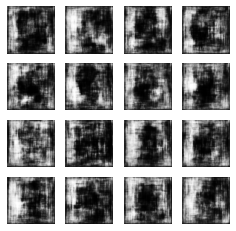

200 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


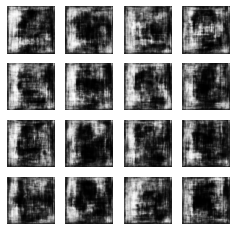

300 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


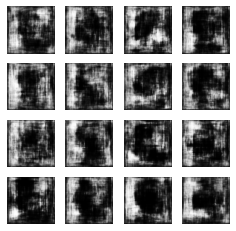

400 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


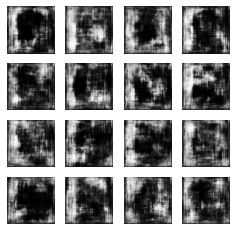

500 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


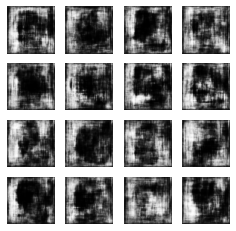

600 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


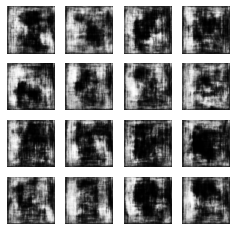

700 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


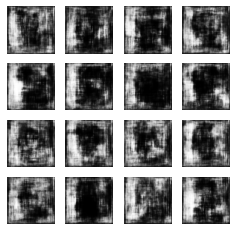

800 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


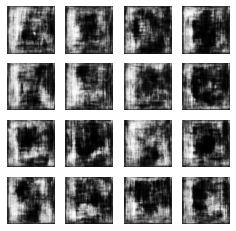

900 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


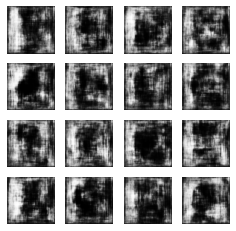

1000 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


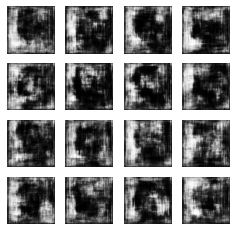

1100 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


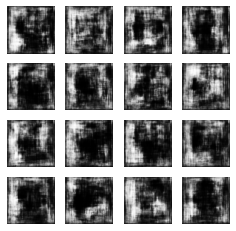

1200 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


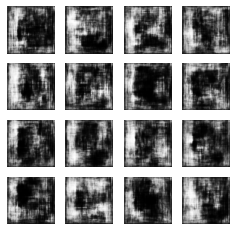

1300 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


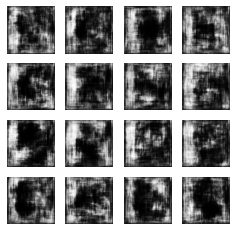

1400 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


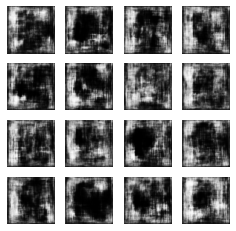

1500 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


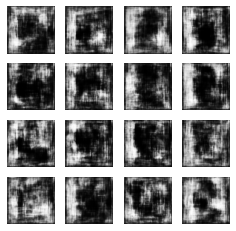

1600 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


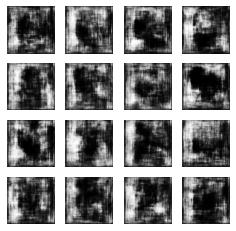

1700 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


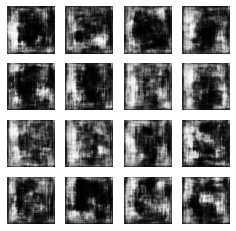

1800 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


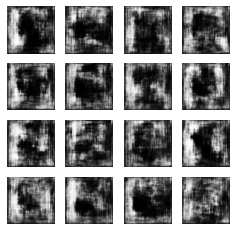

1900 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


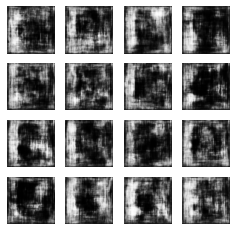

2000 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


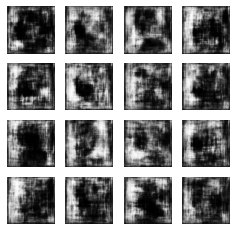

2100 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


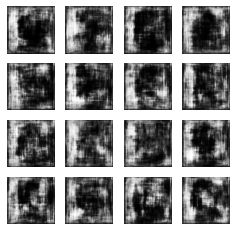

2200 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


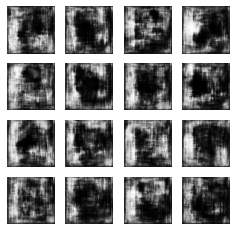

2300 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


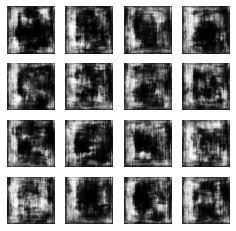

2400 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


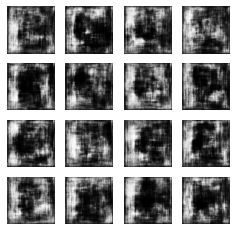

2500 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


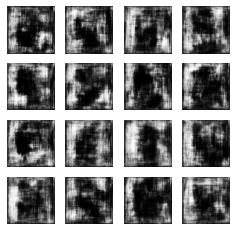

2600 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


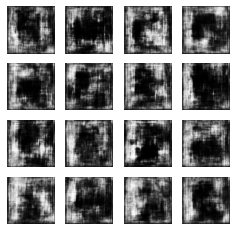

2700 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


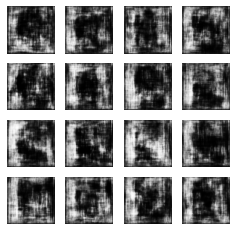

2800 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


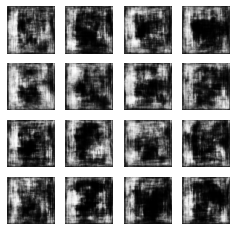

2900 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


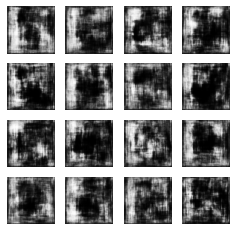

3000 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


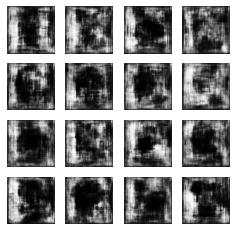

3100 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


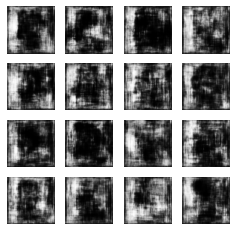

3200 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


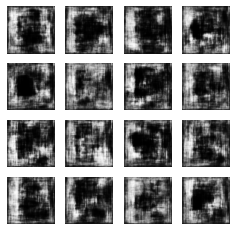

3300 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


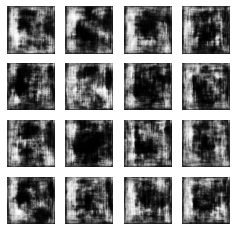

3400 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


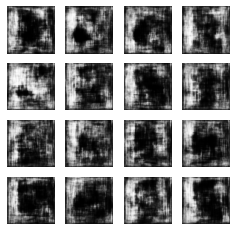

3500 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


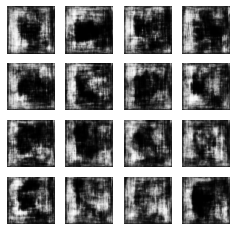

3600 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


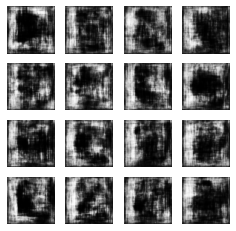

3700 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


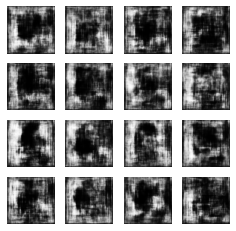

3800 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


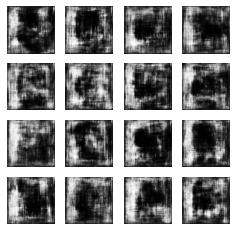

3900 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


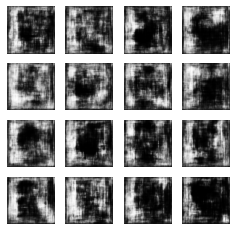

4000 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


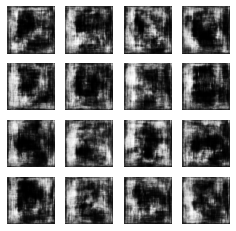

4100 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


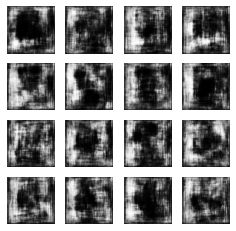

4200 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


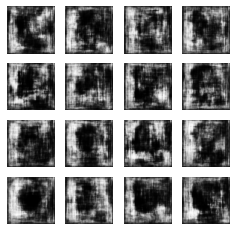

4300 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


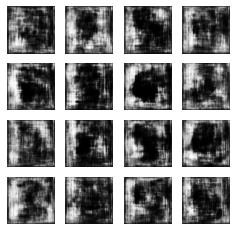

4400 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


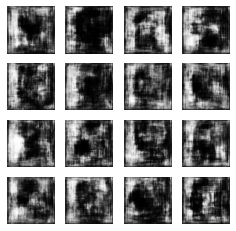

4500 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


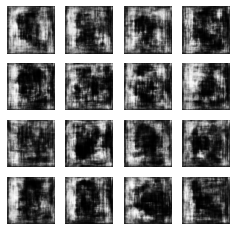

4600 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


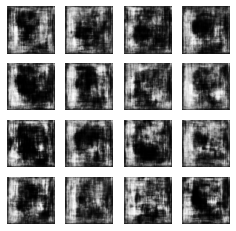

4700 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


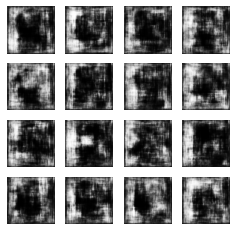

4800 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


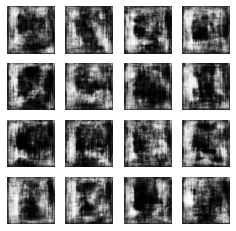

4900 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


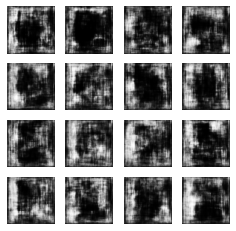

5000 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


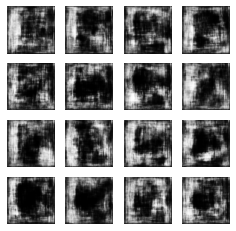

5100 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


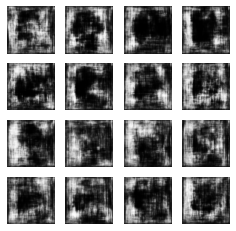

5200 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


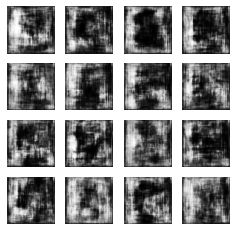

5300 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


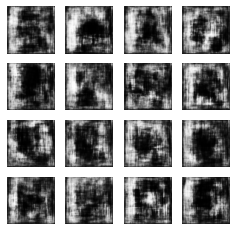

5400 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


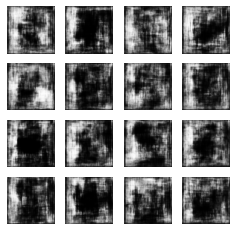

5500 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


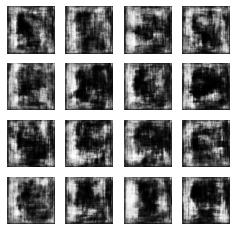

5600 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


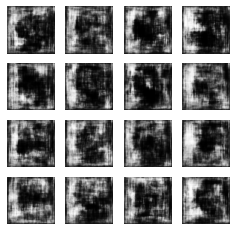

5700 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


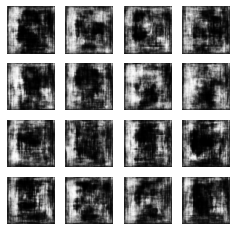

5800 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


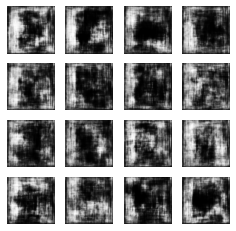

5900 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


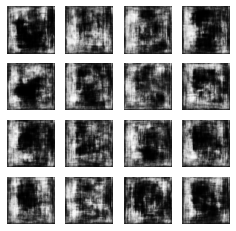

6000 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


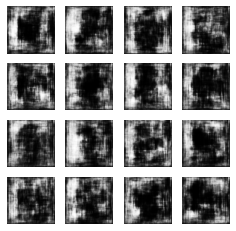

6100 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


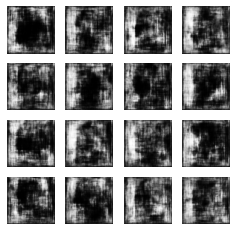

6200 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


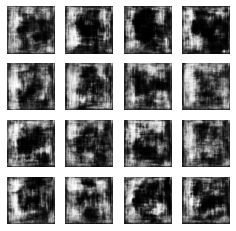

6300 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


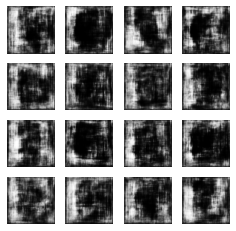

6400 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


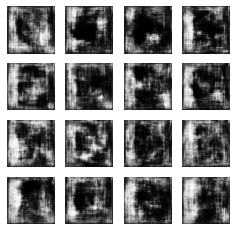

6500 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


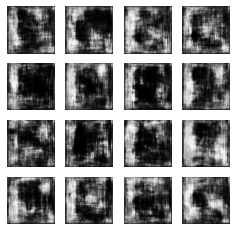

6600 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


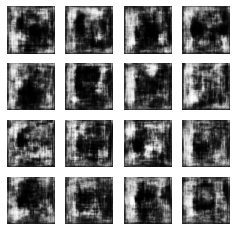

6700 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


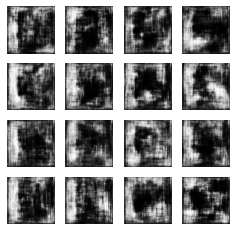

6800 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


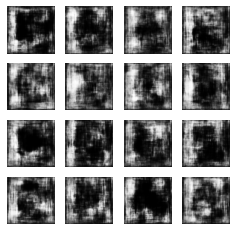

6900 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


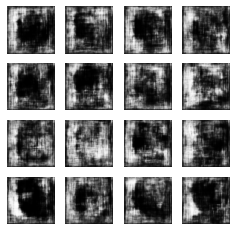

7000 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


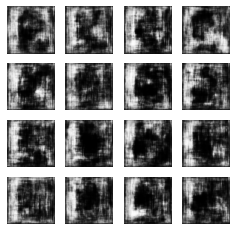

7100 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


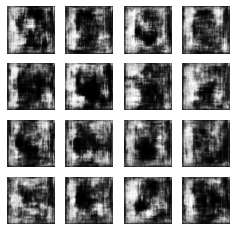

7200 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


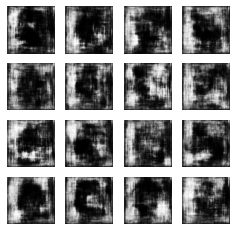

7300 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


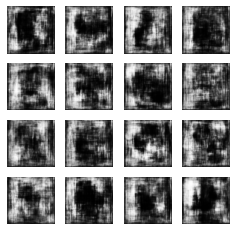

7400 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


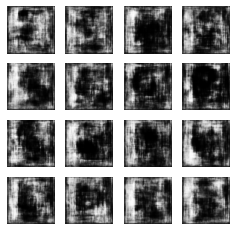

7500 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


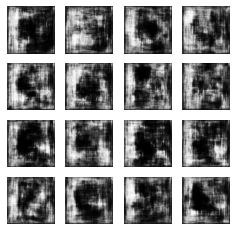

7600 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


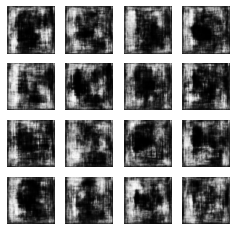

7700 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


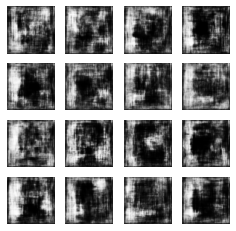

7800 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


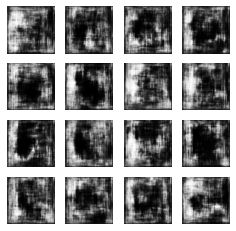

7900 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


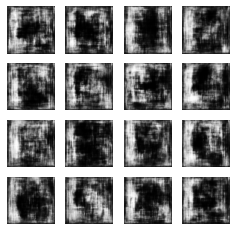

8000 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


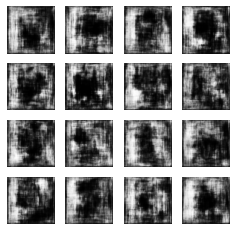

8100 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


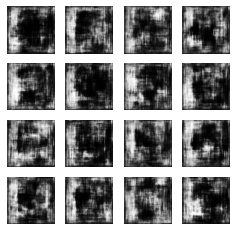

8200 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


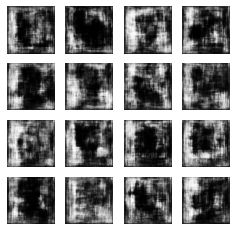

8300 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


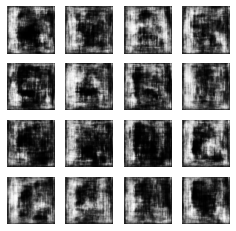

8400 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


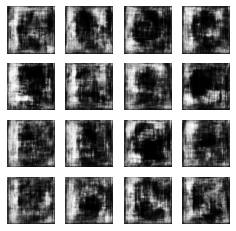

8500 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


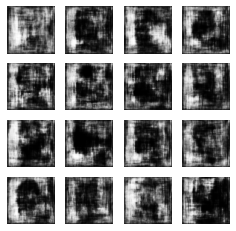

8600 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


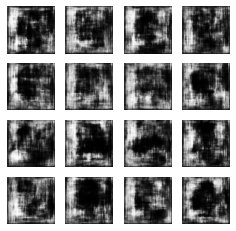

8700 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


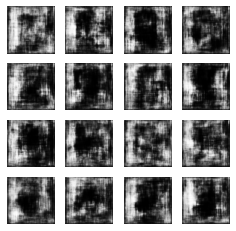

8800 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


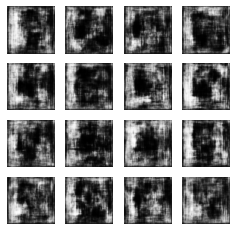

8900 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


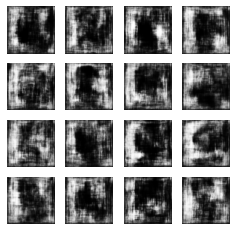

9000 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


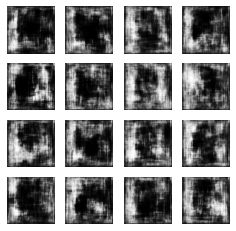

9100 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


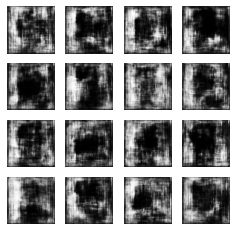

9200 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


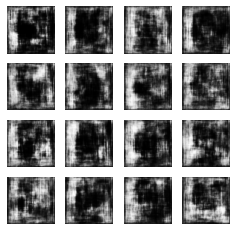

9300 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


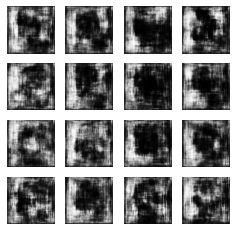

9400 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


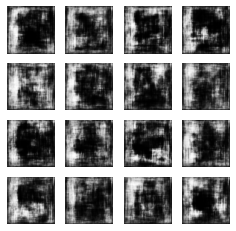

9500 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


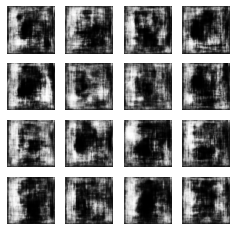

9600 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


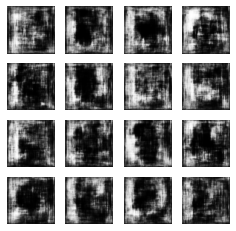

9700 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


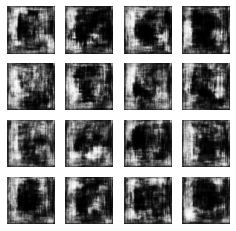

9800 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


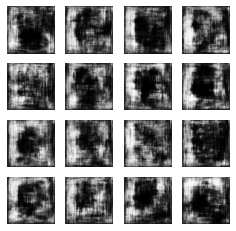

9900 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


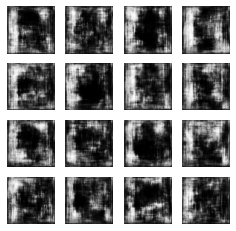

10000 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


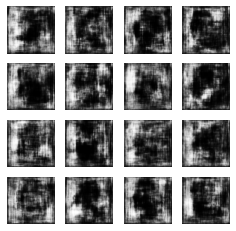

10100 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


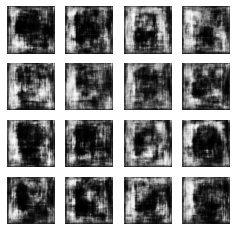

10200 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


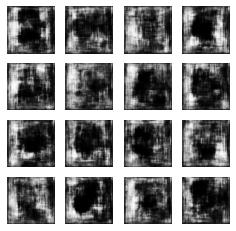

10300 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


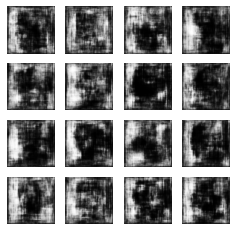

10400 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


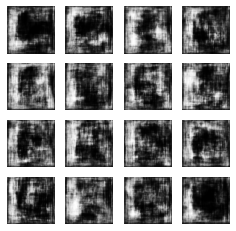

10500 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


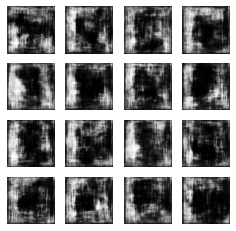

10600 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


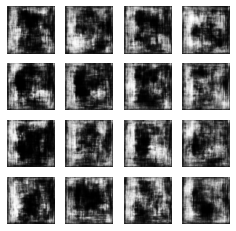

10700 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


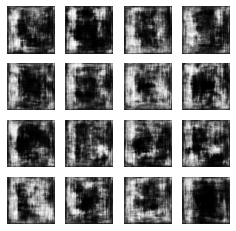

10800 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


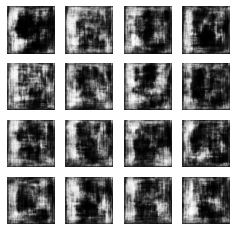

10900 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


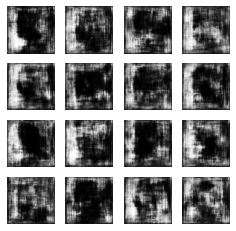

11000 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


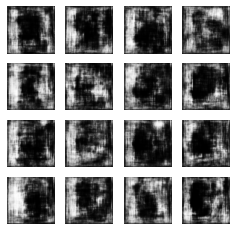

11100 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


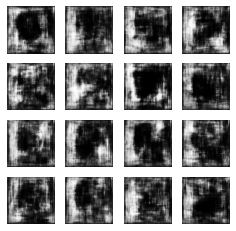

11200 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


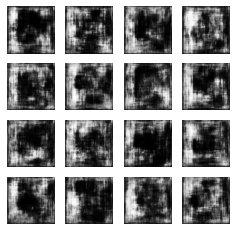

11300 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


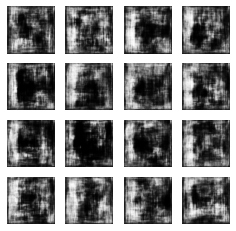

11400 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


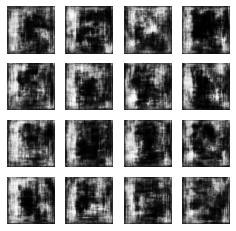

11500 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


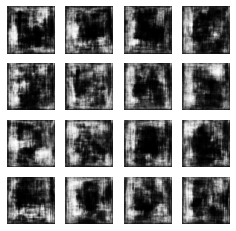

11600 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


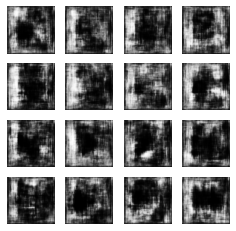

11700 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


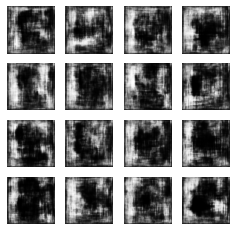

11800 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


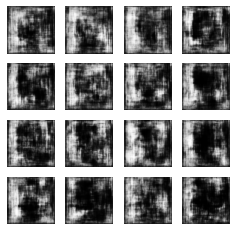

11900 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


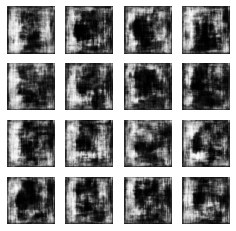

12000 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


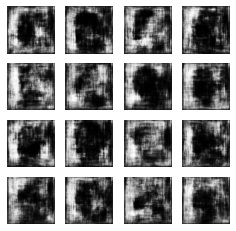

12100 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


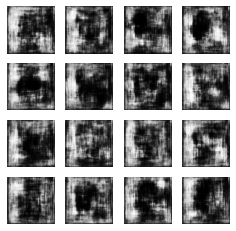

12200 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


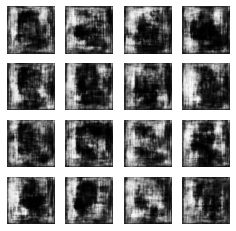

12300 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


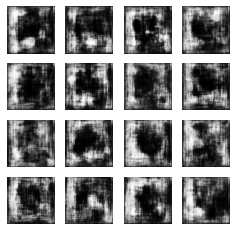

12400 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


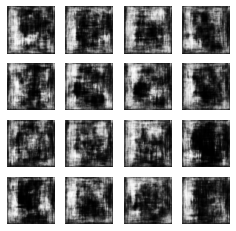

12500 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


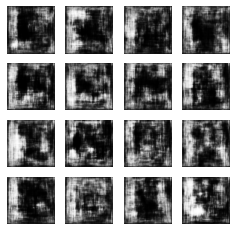

12600 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


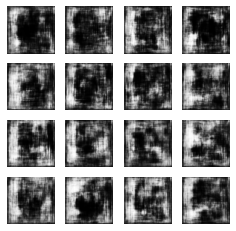

12700 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


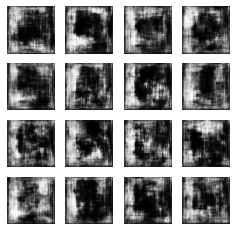

12800 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


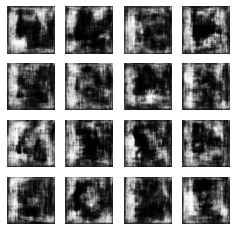

12900 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


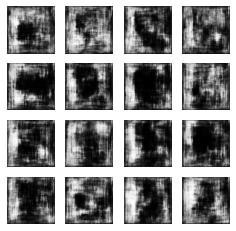

13000 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


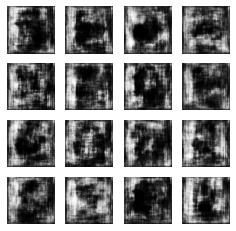

13100 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


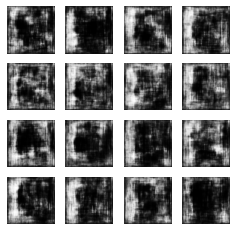

13200 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


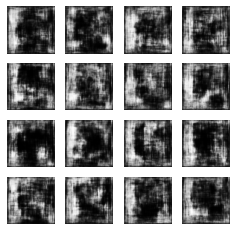

13300 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


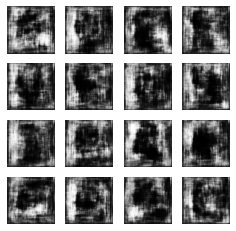

13400 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


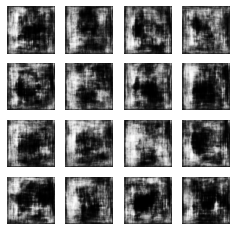

13500 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


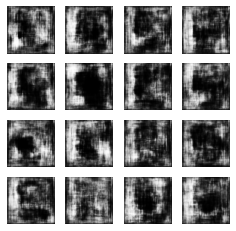

13600 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


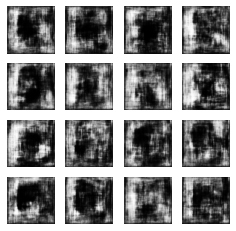

13700 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


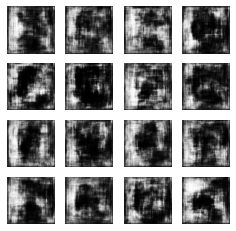

13800 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


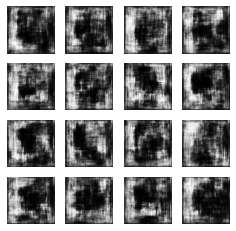

13900 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


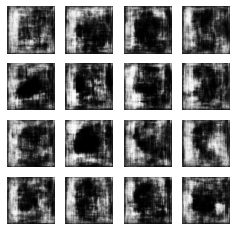

14000 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


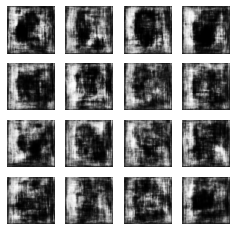

14100 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


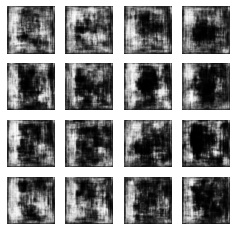

14200 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


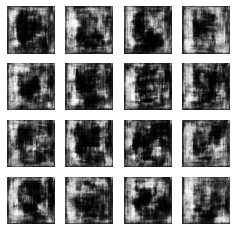

14300 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


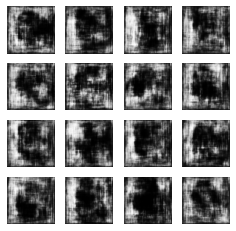

14400 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


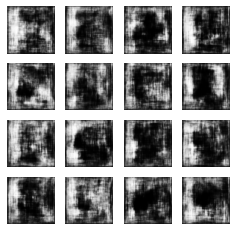

14500 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


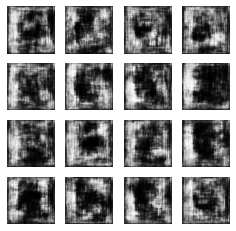

14600 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


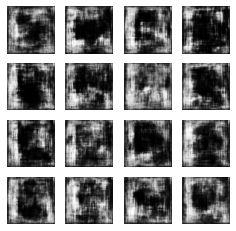

14700 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


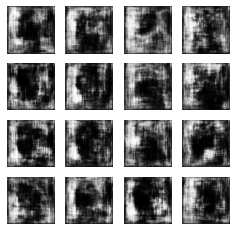

14800 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


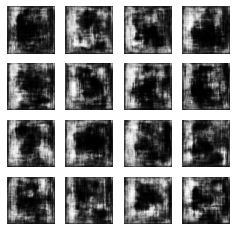

14900 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


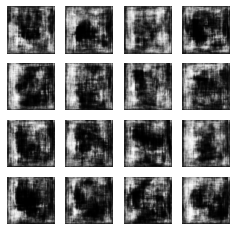

15000 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


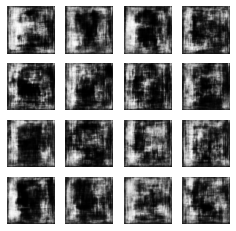

15100 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


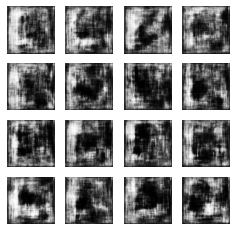

15200 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


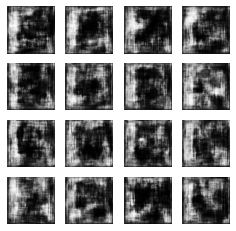

15300 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


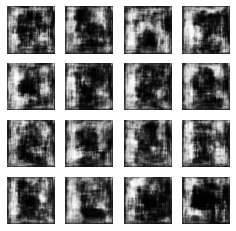

15400 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


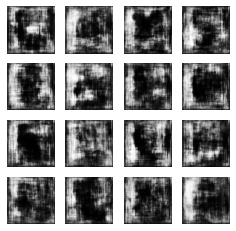

15500 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


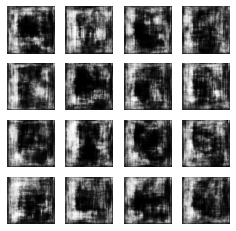

15600 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


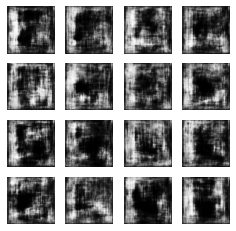

15700 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


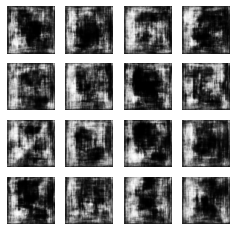

15800 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


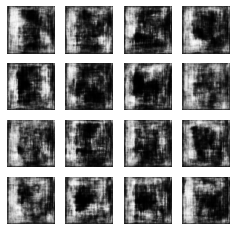

15900 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


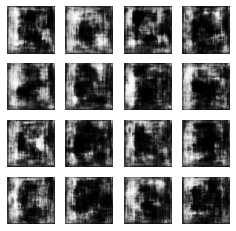

16000 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


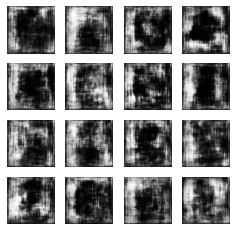

16100 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


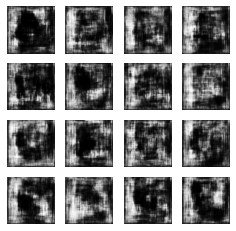

16200 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


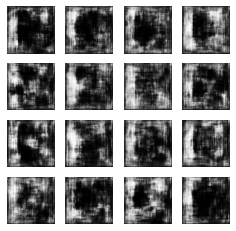

16300 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


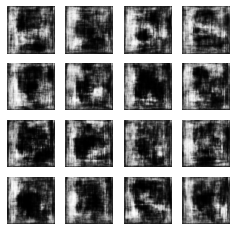

16400 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


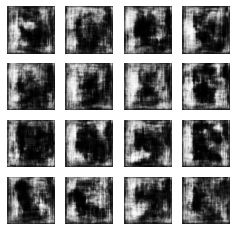

16500 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


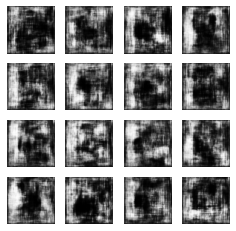

16600 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


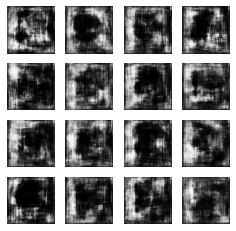

16700 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


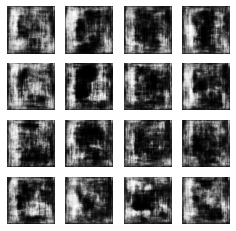

16800 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


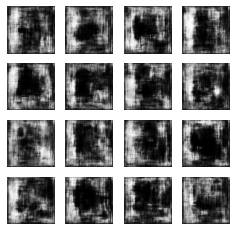

16900 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


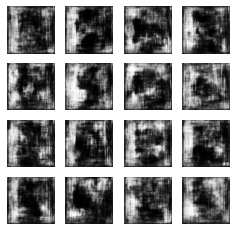

17000 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


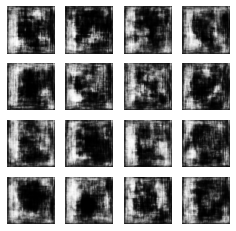

17100 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


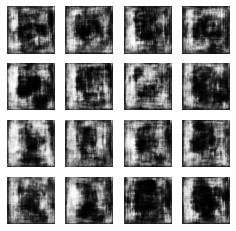

17200 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


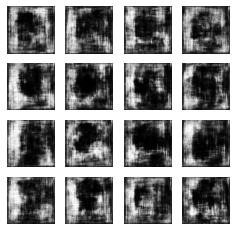

17300 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


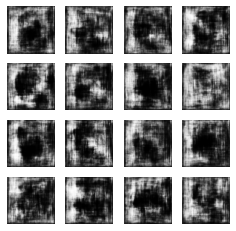

17400 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


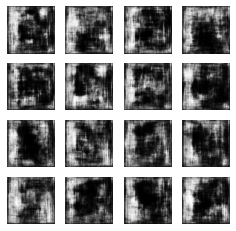

17500 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


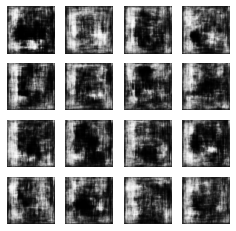

17600 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


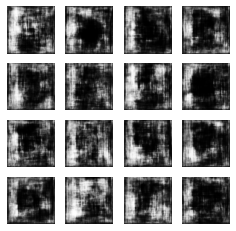

17700 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


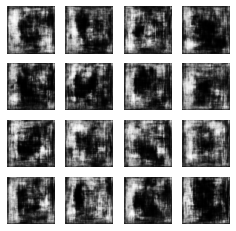

17800 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


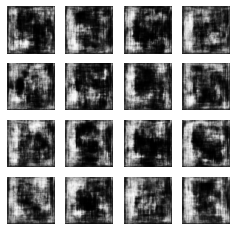

17900 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


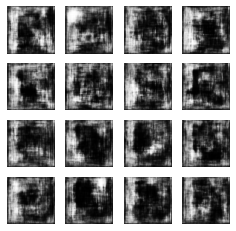

18000 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


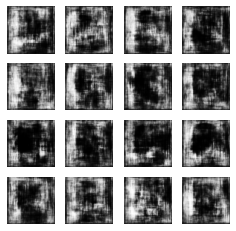

18100 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


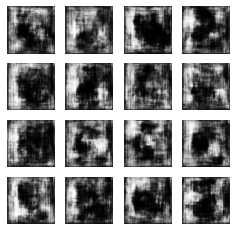

18200 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


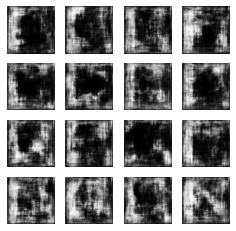

18300 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


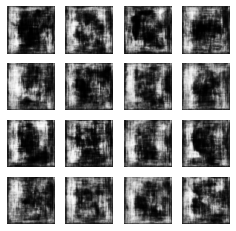

18400 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


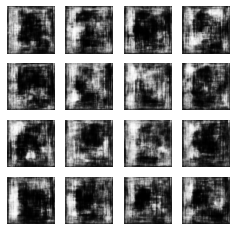

18500 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


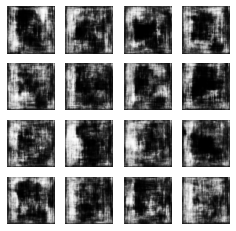

18600 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


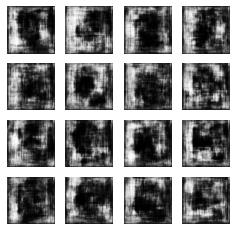

18700 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


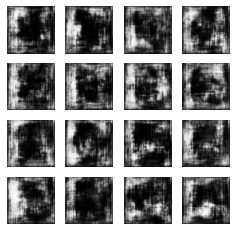

18800 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


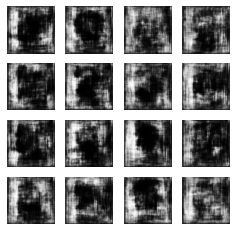

18900 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


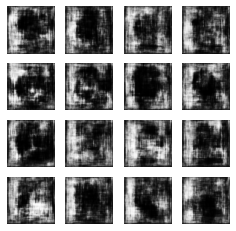

19000 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


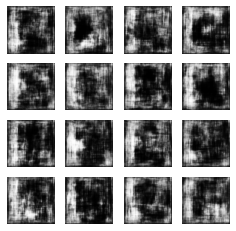

19100 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


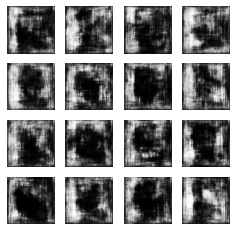

19200 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


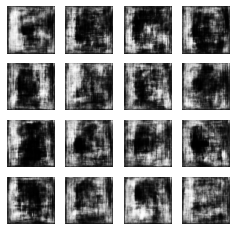

19300 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


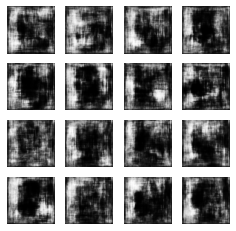

19400 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


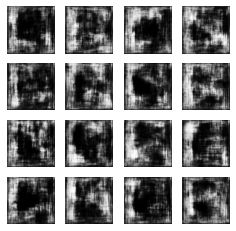

19500 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


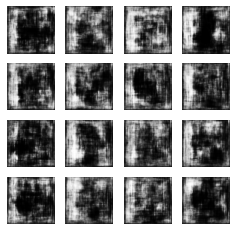

19600 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


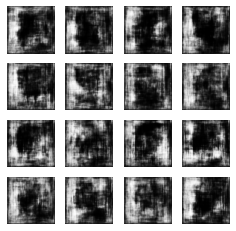

19700 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


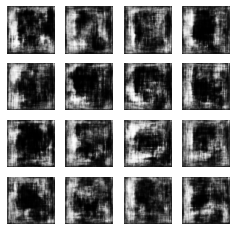

19800 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


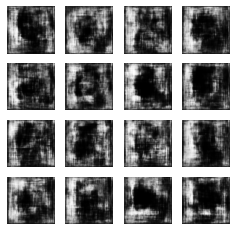

19900 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


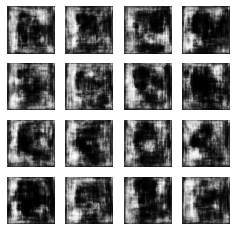

20000 [D loss: 0.000000, acc.: 50.00%] [G loss: 0.000000]


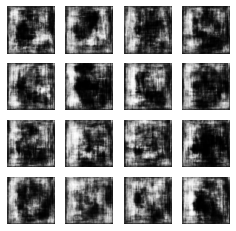

In [9]:
# Set hyperparameters
iterations = 20000
batch_size = 64
sample_interval = 100

# Train the DCGAN for the specified number of iterations
train(iterations, batch_size, sample_interval)

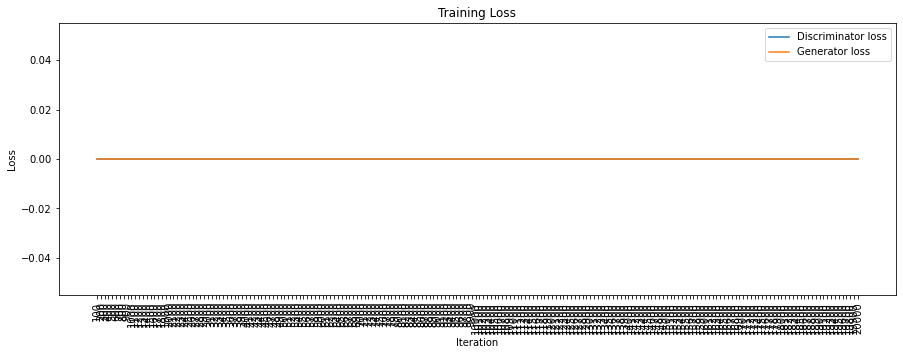

In [10]:
losses = np.array(losses)

# Plot training losses for Discriminator and Generator
plt.figure(figsize=(15, 5))
plt.plot(iteration_checkpoints, losses.T[0], label="Discriminator loss")
plt.plot(iteration_checkpoints, losses.T[1], label="Generator loss")

plt.xticks(iteration_checkpoints, rotation=90)

plt.title("Training Loss")
plt.xlabel("Iteration")
plt.ylabel("Loss")
plt.legend()

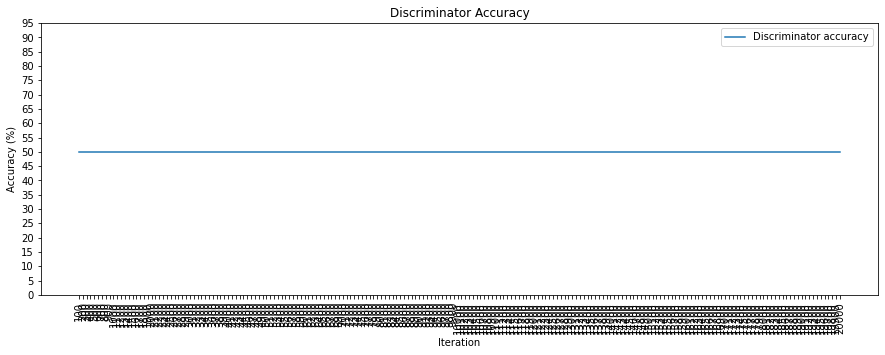

In [11]:
accuracies = np.array(accuracies)

# Plot Discriminator accuracy
plt.figure(figsize=(15, 5))
plt.plot(iteration_checkpoints, accuracies, label="Discriminator accuracy")

plt.xticks(iteration_checkpoints, rotation=90)
plt.yticks(range(0, 100, 5))

plt.title("Discriminator Accuracy")
plt.xlabel("Iteration")
plt.ylabel("Accuracy (%)")
plt.legend()